Họ và tên: Phạm Đức Thể

MSSV: 19522253

Lớp: DS104.N11

FINAL PROJECT - 23/12/2022

Dataset: [Smart Home Dataset with weather Information](https://www.kaggle.com/datasets/taranvee/smart-home-dataset-with-weather-information)

[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/drive/1tF3JuYjMrELLiLR8iOmZ9Yy5muDro79a?usp=sharing)

## **Import libraries**

In [ ]:
# Install latest pre-release version of bigdl-chronos
# Installing bigdl-chronos from pypi
!pip install --pre --upgrade bigdl-chronos[pytorch]
!pip uninstall -y torchtext # uninstall torchtext to avoid version conflict
# exit() # restart the runtime to refresh installed pkg

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 341.8/341.8 KB 6.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 36.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 61.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 512.4/512.4 KB 41.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 890.2/890.2 MB 1.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.3/24.3 MB 13.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.4/41.4 MB 13.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.6/2.6 MB 64.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 585.5/585.5 KB 45.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 557.1/557.1 MB 2.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 317.1/317.1

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import altair as alt
import plotly.express as px
import plotly.graph_objects as go
import warnings
import time

from statsmodels.tsa.arima.model import ARIMA
from sklearn.metrics import mean_squared_error
from math import sqrt
from tqdm import tqdm
from IPython.display import HTML, display
from IPython.core.display import clear_output
from keras.callbacks import EarlyStopping
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import *
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.losses import MeanSquaredError
from tensorflow.keras.metrics import RootMeanSquaredError
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.models import load_model
from bigdl.chronos.data import TSDataset
from sklearn.preprocessing import StandardScaler
from bigdl.chronos.forecaster.tcn_forecaster import TCNForecaster
from bigdl.chronos.forecaster.lstm_forecaster import LSTMForecaster
from bigdl.chronos.forecaster.seq2seq_forecaster import Seq2SeqForecaster

warnings.filterwarnings("ignore")
sns.set()

## **Read Data**

In [ ]:
PATH = '/content/drive/MyDrive/Dataset/DS104.N11/Final Project/'

In [ ]:
%%time
df = pd.read_csv(PATH+'HomeC.csv')
df

CPU times: user 3.37 s, sys: 308 ms, total: 3.68 s
Wall time: 7.16 s


,time,use [kW],gen [kW],House overall [kW],Dishwasher [kW],Furnace 1 [kW],Furnace 2 [kW],Home office [kW],Fridge [kW],Wine cellar [kW],...,visibility,summary,apparentTemperature,pressure,windSpeed,cloudCover,windBearing,precipIntensity,dewPoint,precipProbability
0,1451624400,0.932833,0.003483,0.932833,0.000033,0.020700,0.061917,0.442633,0.124150,0.006983,...,10.00,Clear,29.26,1016.91,9.18,cloudCover,282.0,0.0000,24.40,0.00
1,1451624401,0.934333,0.003467,0.934333,0.000000,0.020717,0.063817,0.444067,0.124000,0.006983,...,10.00,Clear,29.26,1016.91,9.18,cloudCover,282.0,0.0000,24.40,0.00
2,1451624402,0.931817,0.003467,0.931817,0.000017,0.020700,0.062317,0.446067,0.123533,0.006983,...,10.00,Clear,29.26,1016.91,9.18,cloudCover,282.0,0.0000,24.40,0.00
3,1451624403,1.022050,0.003483,1.022050,0.000017,0.106900,0.068517,0.446583,0.123133,0.006983,...,10.00,Clear,29.26,1016.91,9.18,cloudCover,282.0,0.0000,24.40,0.00
4,1451624404,1.139400,0.003467,1.139400,0.000133,0.236933,0.063983,0.446533,0.122850,0.006850,...,10.00,Clear,29.26,1016.91,9.18,cloudCover,282.0,0.0000,24.40,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
503906,1452128306,1.599333,0.003233,1.599333,0.000050,0.104017,0.625033,0.041750,0.005233,0.008433,...,8.74,Light Rain,29.45,1011.49,6.72,0.31,186.0,0.0101,31.27,0.51
503907,1452128307,1.924267,0.003217,1.924267,0.000033,0.422383,0.637733,0.042033,0.004983,0.008467,...,8.74,Light Rain,29.45,1011.49,6.72,0.31,186.0,0.0101,31.27,0.51
503908,1452128308,1.978200,0.003217,1.978200,0.000050,0.495667,0.620367,0.042100,0.005333,0.008233,...,8.74,Light Rain,29.45,1011.49,6.72,0.31,186.0,0.0101,31.27,0.51
503909,1452128309,1.990950,0.003233,1.990950,0.000050,0.494700,0.634133,0.042100,0.004917,0.008133,...,8.74,Light Rain,29.45,1011.49,6.72,0.31,186.0,0.0101,31.27,0.51


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 503911 entries, 0 to 503910
Data columns (total 32 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   time                 503911 non-null  object 
 1   use [kW]             503910 non-null  float64
 2   gen [kW]             503910 non-null  float64
 3   House overall [kW]   503910 non-null  float64
 4   Dishwasher [kW]      503910 non-null  float64
 5   Furnace 1 [kW]       503910 non-null  float64
 6   Furnace 2 [kW]       503910 non-null  float64
 7   Home office [kW]     503910 non-null  float64
 8   Fridge [kW]          503910 non-null  float64
 9   Wine cellar [kW]     503910 non-null  float64
 10  Garage door [kW]     503910 non-null  float64
 11  Kitchen 12 [kW]      503910 non-null  float64
 12  Kitchen 14 [kW]      503910 non-null  float64
 13  Kitchen 38 [kW]      503910 non-null  float64
 14  Barn [kW]            503910 non-null  float64
 15  Well [kW]        

In [ ]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
use [kW],503910.0,0.858962,1.058207,0.000000,0.367667,0.562333,0.970250,14.714567
gen [kW],503910.0,0.076229,0.128428,0.000000,0.003367,0.004283,0.083917,0.613883
House overall [kW],503910.0,0.858962,1.058207,0.000000,0.367667,0.562333,0.970250,14.714567
Dishwasher [kW],503910.0,0.031368,0.190951,0.000000,0.000000,0.000017,0.000233,1.401767
Furnace 1 [kW],503910.0,0.099210,0.169059,0.000017,0.020233,0.020617,0.068733,1.934083
Furnace 2 [kW],503910.0,0.136779,0.178631,0.000067,0.064400,0.066633,0.080633,0.794933
Home office [kW],503910.0,0.081287,0.104466,0.000083,0.040383,0.042217,0.068283,0.971750
Fridge [kW],503910.0,0.063556,0.076199,0.000067,0.005083,0.005433,0.125417,0.851267
Wine cellar [kW],503910.0,0.042137,0.057967,0.000017,0.007133,0.008083,0.053192,1.273933
Garage door [kW],503910.0,0.014139,0.014292,0.000017,0.012733,0.012933,0.013100,1.088983


## **Pre-processing**

### **Rename columns**

In [ ]:
df.columns

Index(['time', 'use [kW]', 'gen [kW]', 'House overall [kW]', 'Dishwasher [kW]',
       'Furnace 1 [kW]', 'Furnace 2 [kW]', 'Home office [kW]', 'Fridge [kW]',
       'Wine cellar [kW]', 'Garage door [kW]', 'Kitchen 12 [kW]',
       'Kitchen 14 [kW]', 'Kitchen 38 [kW]', 'Barn [kW]', 'Well [kW]',
       'Microwave [kW]', 'Living room [kW]', 'Solar [kW]', 'temperature',
       'icon', 'humidity', 'visibility', 'summary', 'apparentTemperature',
       'pressure', 'windSpeed', 'cloudCover', 'windBearing', 'precipIntensity',
       'dewPoint', 'precipProbability'],
      dtype='object')

In [ ]:
# remove unit(kW) from dataset column names.
df.columns = [i.replace(' [kW]', '') for i in df.columns]
df.columns

Index(['time', 'use', 'gen', 'House overall', 'Dishwasher', 'Furnace 1',
       'Furnace 2', 'Home office', 'Fridge', 'Wine cellar', 'Garage door',
       'Kitchen 12', 'Kitchen 14', 'Kitchen 38', 'Barn', 'Well', 'Microwave',
       'Living room', 'Solar', 'temperature', 'icon', 'humidity', 'visibility',
       'summary', 'apparentTemperature', 'pressure', 'windSpeed', 'cloudCover',
       'windBearing', 'precipIntensity', 'dewPoint', 'precipProbability'],
      dtype='object')

In [ ]:
# There are multiple columns in Furnance and Kitchen. To make it simple, I aggregated them into new columns by summing them up.
df['Furnace'] = df[['Furnace 1','Furnace 2']].sum(axis=1)
df['Kitchen'] = df[['Kitchen 12','Kitchen 14','Kitchen 38']].sum(axis=1)
df.drop(['Furnace 1','Furnace 2','Kitchen 12','Kitchen 14','Kitchen 38'], axis=1, inplace=True)

In [ ]:
df

,time,use,gen,House overall,Dishwasher,Home office,Fridge,Wine cellar,Garage door,Barn,...,apparentTemperature,pressure,windSpeed,cloudCover,windBearing,precipIntensity,dewPoint,precipProbability,Furnace,Kitchen
0,1451624400,0.932833,0.003483,0.932833,0.000033,0.442633,0.124150,0.006983,0.013083,0.031350,...,29.26,1016.91,9.18,cloudCover,282.0,0.0000,24.40,0.00,0.082617,0.000567
1,1451624401,0.934333,0.003467,0.934333,0.000000,0.444067,0.124000,0.006983,0.013117,0.031500,...,29.26,1016.91,9.18,cloudCover,282.0,0.0000,24.40,0.00,0.084533,0.000567
2,1451624402,0.931817,0.003467,0.931817,0.000017,0.446067,0.123533,0.006983,0.013083,0.031517,...,29.26,1016.91,9.18,cloudCover,282.0,0.0000,24.40,0.00,0.083017,0.000617
3,1451624403,1.022050,0.003483,1.022050,0.000017,0.446583,0.123133,0.006983,0.013000,0.031500,...,29.26,1016.91,9.18,cloudCover,282.0,0.0000,24.40,0.00,0.175417,0.000650
4,1451624404,1.139400,0.003467,1.139400,0.000133,0.446533,0.122850,0.006850,0.012783,0.031500,...,29.26,1016.91,9.18,cloudCover,282.0,0.0000,24.40,0.00,0.300917,0.000783
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
503906,1452128306,1.599333,0.003233,1.599333,0.000050,0.041750,0.005233,0.008433,0.013433,0.032200,...,29.45,1011.49,6.72,0.31,186.0,0.0101,31.27,0.51,0.729050,0.000600
503907,1452128307,1.924267,0.003217,1.924267,0.000033,0.042033,0.004983,0.008467,0.012933,0.032283,...,29.45,1011.49,6.72,0.31,186.0,0.0101,31.27,0.51,1.060117,0.000600
503908,1452128308,1.978200,0.003217,1.978200,0.000050,0.042100,0.005333,0.008233,0.012817,0.032183,...,29.45,1011.49,6.72,0.31,186.0,0.0101,31.27,0.51,1.116033,0.000650
503909,1452128309,1.990950,0.003233,1.990950,0.000050,0.042100,0.004917,0.008133,0.012833,0.032167,...,29.45,1011.49,6.72,0.31,186.0,0.0101,31.27,0.51,1.128833,0.000650


### **Drop NAs**

There is a row that contains NaN.

In [ ]:
# Check NaN
df[df.isnull().any(axis=1)]

,time,use,gen,House overall,Dishwasher,Home office,Fridge,Wine cellar,Garage door,Barn,...,apparentTemperature,pressure,windSpeed,cloudCover,windBearing,precipIntensity,dewPoint,precipProbability,Furnace,Kitchen
503910,\,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0


In [ ]:
# The last row contains NaN, so we remove it from the dataset.
df = df[:-1]
df

,time,use,gen,House overall,Dishwasher,Home office,Fridge,Wine cellar,Garage door,Barn,...,apparentTemperature,pressure,windSpeed,cloudCover,windBearing,precipIntensity,dewPoint,precipProbability,Furnace,Kitchen
0,1451624400,0.932833,0.003483,0.932833,0.000033,0.442633,0.124150,0.006983,0.013083,0.031350,...,29.26,1016.91,9.18,cloudCover,282.0,0.0000,24.40,0.00,0.082617,0.000567
1,1451624401,0.934333,0.003467,0.934333,0.000000,0.444067,0.124000,0.006983,0.013117,0.031500,...,29.26,1016.91,9.18,cloudCover,282.0,0.0000,24.40,0.00,0.084533,0.000567
2,1451624402,0.931817,0.003467,0.931817,0.000017,0.446067,0.123533,0.006983,0.013083,0.031517,...,29.26,1016.91,9.18,cloudCover,282.0,0.0000,24.40,0.00,0.083017,0.000617
3,1451624403,1.022050,0.003483,1.022050,0.000017,0.446583,0.123133,0.006983,0.013000,0.031500,...,29.26,1016.91,9.18,cloudCover,282.0,0.0000,24.40,0.00,0.175417,0.000650
4,1451624404,1.139400,0.003467,1.139400,0.000133,0.446533,0.122850,0.006850,0.012783,0.031500,...,29.26,1016.91,9.18,cloudCover,282.0,0.0000,24.40,0.00,0.300917,0.000783
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
503905,1452128305,1.601233,0.003183,1.601233,0.000050,0.041783,0.005267,0.008667,0.013483,0.032283,...,29.45,1011.49,6.72,0.31,186.0,0.0101,31.27,0.51,0.727683,0.000633
503906,1452128306,1.599333,0.003233,1.599333,0.000050,0.041750,0.005233,0.008433,0.013433,0.032200,...,29.45,1011.49,6.72,0.31,186.0,0.0101,31.27,0.51,0.729050,0.000600
503907,1452128307,1.924267,0.003217,1.924267,0.000033,0.042033,0.004983,0.008467,0.012933,0.032283,...,29.45,1011.49,6.72,0.31,186.0,0.0101,31.27,0.51,1.060117,0.000600
503908,1452128308,1.978200,0.003217,1.978200,0.000050,0.042100,0.005333,0.008233,0.012817,0.032183,...,29.45,1011.49,6.72,0.31,186.0,0.0101,31.27,0.51,1.116033,0.000650


### **Invalid Rows**

There are invalid values in `'cloudCover'` column because it must be float64-type but it is object-type.

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 503910 entries, 0 to 503909
Data columns (total 29 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   time                 503910 non-null  object 
 1   use                  503910 non-null  float64
 2   gen                  503910 non-null  float64
 3   House overall        503910 non-null  float64
 4   Dishwasher           503910 non-null  float64
 5   Home office          503910 non-null  float64
 6   Fridge               503910 non-null  float64
 7   Wine cellar          503910 non-null  float64
 8   Garage door          503910 non-null  float64
 9   Barn                 503910 non-null  float64
 10  Well                 503910 non-null  float64
 11  Microwave            503910 non-null  float64
 12  Living room          503910 non-null  float64
 13  Solar                503910 non-null  float64
 14  temperature          503910 non-null  float64
 15  icon             

In [ ]:
df['cloudCover'].unique()

array(['cloudCover', '0.75', '0', '1', '0.31', '0.44', '0.13', '0.19',
       '0.25', '0.16', '0.21', '0.15', '0.14', '0.27', '0.28', '0.17',
       '0.05', '0.1', '0.26', '0.29', '0.11', '0.09', '0.12', '0.06',
       '0.02', '0.08', '0.04', '0.35', '0.22', '0.23', '0.54', '0.39',
       '0.03', '0.07', '0.76', '0.62', '0.18', '0.79', '0.48', '0.24',
       '0.57', 0.24, 1.0, 0.31, 0.28, 0.15, 0.41, 0.1, 0.12, 0.08, 0.09,
       0.19, 0.04, 0.05, 0.29, 0.27, 0.35, 0.18, 0.06, 0.03, 0.11, 0.14,
       0.25, 0.78, 0.0, 0.16, 0.21, 0.23, 0.17, 0.75, 0.26, 0.2, 0.76,
       0.13, 0.77, 0.46, 0.07, 0.55, 0.02, 0.01, 0.51, 0.47, 0.5, 0.4,
       0.3, 0.22, 0.43, 0.33, 0.6, 0.68, 0.66, 0.45, 0.34, 0.52, 0.67,
       0.48, 0.49, 0.39, 0.37, 0.62, 0.36, 0.79, 0.61, 0.38, 0.42, 0.53,
       0.63, 0.44, 0.54, 0.32, 0.56, 0.58, 0.72, 0.57, 0.73, 0.71, 0.64,
       0.59], dtype=object)

In [ ]:
df[df['cloudCover']=='cloudCover'].shape

(58, 29)

`'cloudCover'` value was found in the column (58 rows). Maybe this is a data collection mistake.

In [ ]:
# So let's replace these invalid values with the next valid value.
df['cloudCover'].replace(['cloudCover'], method='bfill', inplace=True)
df['cloudCover'] = df['cloudCover'].astype('float')

In [ ]:
df

,time,use,gen,House overall,Dishwasher,Home office,Fridge,Wine cellar,Garage door,Barn,...,apparentTemperature,pressure,windSpeed,cloudCover,windBearing,precipIntensity,dewPoint,precipProbability,Furnace,Kitchen
0,1451624400,0.932833,0.003483,0.932833,0.000033,0.442633,0.124150,0.006983,0.013083,0.031350,...,29.26,1016.91,9.18,0.75,282.0,0.0000,24.40,0.00,0.082617,0.000567
1,1451624401,0.934333,0.003467,0.934333,0.000000,0.444067,0.124000,0.006983,0.013117,0.031500,...,29.26,1016.91,9.18,0.75,282.0,0.0000,24.40,0.00,0.084533,0.000567
2,1451624402,0.931817,0.003467,0.931817,0.000017,0.446067,0.123533,0.006983,0.013083,0.031517,...,29.26,1016.91,9.18,0.75,282.0,0.0000,24.40,0.00,0.083017,0.000617
3,1451624403,1.022050,0.003483,1.022050,0.000017,0.446583,0.123133,0.006983,0.013000,0.031500,...,29.26,1016.91,9.18,0.75,282.0,0.0000,24.40,0.00,0.175417,0.000650
4,1451624404,1.139400,0.003467,1.139400,0.000133,0.446533,0.122850,0.006850,0.012783,0.031500,...,29.26,1016.91,9.18,0.75,282.0,0.0000,24.40,0.00,0.300917,0.000783
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
503905,1452128305,1.601233,0.003183,1.601233,0.000050,0.041783,0.005267,0.008667,0.013483,0.032283,...,29.45,1011.49,6.72,0.31,186.0,0.0101,31.27,0.51,0.727683,0.000633
503906,1452128306,1.599333,0.003233,1.599333,0.000050,0.041750,0.005233,0.008433,0.013433,0.032200,...,29.45,1011.49,6.72,0.31,186.0,0.0101,31.27,0.51,0.729050,0.000600
503907,1452128307,1.924267,0.003217,1.924267,0.000033,0.042033,0.004983,0.008467,0.012933,0.032283,...,29.45,1011.49,6.72,0.31,186.0,0.0101,31.27,0.51,1.060117,0.000600
503908,1452128308,1.978200,0.003217,1.978200,0.000050,0.042100,0.005333,0.008233,0.012817,0.032183,...,29.45,1011.49,6.72,0.31,186.0,0.0101,31.27,0.51,1.116033,0.000650


### **Datetime information**

After converting unixtimestamp, I realized the time-step is in increments of seconds though the data was collected with time-span of 1 minute.

In [ ]:
pd.to_datetime(df['time'], unit='s')

0        2016-01-01 05:00:00
1        2016-01-01 05:00:01
2        2016-01-01 05:00:02
3        2016-01-01 05:00:03
4        2016-01-01 05:00:04
                 ...        
503905   2016-01-07 00:58:25
503906   2016-01-07 00:58:26
503907   2016-01-07 00:58:27
503908   2016-01-07 00:58:28
503909   2016-01-07 00:58:29
Name: time, Length: 503910, dtype: datetime64[ns]

In [ ]:
x = pd.to_datetime('1475812080000', unit='ms')
print(x)

2016-10-07 03:48:00


In [ ]:
# We need to create a new date range in increments of minutes.
df['time'] = pd.DatetimeIndex(pd.date_range('2016-01-01 05:00', periods=len(df),  freq='min'))
df

,time,use,gen,House overall,Dishwasher,Home office,Fridge,Wine cellar,Garage door,Barn,...,apparentTemperature,pressure,windSpeed,cloudCover,windBearing,precipIntensity,dewPoint,precipProbability,Furnace,Kitchen
0,2016-01-01 05:00:00,0.932833,0.003483,0.932833,0.000033,0.442633,0.124150,0.006983,0.013083,0.031350,...,29.26,1016.91,9.18,0.75,282.0,0.0000,24.40,0.00,0.082617,0.000567
1,2016-01-01 05:01:00,0.934333,0.003467,0.934333,0.000000,0.444067,0.124000,0.006983,0.013117,0.031500,...,29.26,1016.91,9.18,0.75,282.0,0.0000,24.40,0.00,0.084533,0.000567
2,2016-01-01 05:02:00,0.931817,0.003467,0.931817,0.000017,0.446067,0.123533,0.006983,0.013083,0.031517,...,29.26,1016.91,9.18,0.75,282.0,0.0000,24.40,0.00,0.083017,0.000617
3,2016-01-01 05:03:00,1.022050,0.003483,1.022050,0.000017,0.446583,0.123133,0.006983,0.013000,0.031500,...,29.26,1016.91,9.18,0.75,282.0,0.0000,24.40,0.00,0.175417,0.000650
4,2016-01-01 05:04:00,1.139400,0.003467,1.139400,0.000133,0.446533,0.122850,0.006850,0.012783,0.031500,...,29.26,1016.91,9.18,0.75,282.0,0.0000,24.40,0.00,0.300917,0.000783
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
503905,2016-12-16 03:25:00,1.601233,0.003183,1.601233,0.000050,0.041783,0.005267,0.008667,0.013483,0.032283,...,29.45,1011.49,6.72,0.31,186.0,0.0101,31.27,0.51,0.727683,0.000633
503906,2016-12-16 03:26:00,1.599333,0.003233,1.599333,0.000050,0.041750,0.005233,0.008433,0.013433,0.032200,...,29.45,1011.49,6.72,0.31,186.0,0.0101,31.27,0.51,0.729050,0.000600
503907,2016-12-16 03:27:00,1.924267,0.003217,1.924267,0.000033,0.042033,0.004983,0.008467,0.012933,0.032283,...,29.45,1011.49,6.72,0.31,186.0,0.0101,31.27,0.51,1.060117,0.000600
503908,2016-12-16 03:28:00,1.978200,0.003217,1.978200,0.000050,0.042100,0.005333,0.008233,0.012817,0.032183,...,29.45,1011.49,6.72,0.31,186.0,0.0101,31.27,0.51,1.116033,0.000650


In [ ]:
# To utilize DateTime information such as year, month, and day in EDA and modeling phase, we need to extract them from the time column.
df['year'] = df['time'].apply(lambda x : x.year)
df['month'] = df['time'].apply(lambda x : x.month)
df['day'] = df['time'].apply(lambda x : x.day)
df['weekday'] = df['time'].apply(lambda x : x.day_name())
df['weekofyear'] = df['time'].apply(lambda x : x.weekofyear)
df['hour'] = df['time'].apply(lambda x : x.hour)
df['minute'] = df['time'].apply(lambda x : x.minute)
clear_output()
df

,time,use,gen,House overall,Dishwasher,Home office,Fridge,Wine cellar,Garage door,Barn,...,precipProbability,Furnace,Kitchen,year,month,day,weekday,weekofyear,hour,minute
0,2016-01-01 05:00:00,0.932833,0.003483,0.932833,0.000033,0.442633,0.124150,0.006983,0.013083,0.031350,...,0.00,0.082617,0.000567,2016,1,1,Friday,53,5,0
1,2016-01-01 05:01:00,0.934333,0.003467,0.934333,0.000000,0.444067,0.124000,0.006983,0.013117,0.031500,...,0.00,0.084533,0.000567,2016,1,1,Friday,53,5,1
2,2016-01-01 05:02:00,0.931817,0.003467,0.931817,0.000017,0.446067,0.123533,0.006983,0.013083,0.031517,...,0.00,0.083017,0.000617,2016,1,1,Friday,53,5,2
3,2016-01-01 05:03:00,1.022050,0.003483,1.022050,0.000017,0.446583,0.123133,0.006983,0.013000,0.031500,...,0.00,0.175417,0.000650,2016,1,1,Friday,53,5,3
4,2016-01-01 05:04:00,1.139400,0.003467,1.139400,0.000133,0.446533,0.122850,0.006850,0.012783,0.031500,...,0.00,0.300917,0.000783,2016,1,1,Friday,53,5,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
503905,2016-12-16 03:25:00,1.601233,0.003183,1.601233,0.000050,0.041783,0.005267,0.008667,0.013483,0.032283,...,0.51,0.727683,0.000633,2016,12,16,Friday,50,3,25
503906,2016-12-16 03:26:00,1.599333,0.003233,1.599333,0.000050,0.041750,0.005233,0.008433,0.013433,0.032200,...,0.51,0.729050,0.000600,2016,12,16,Friday,50,3,26
503907,2016-12-16 03:27:00,1.924267,0.003217,1.924267,0.000033,0.042033,0.004983,0.008467,0.012933,0.032283,...,0.51,1.060117,0.000600,2016,12,16,Friday,50,3,27
503908,2016-12-16 03:28:00,1.978200,0.003217,1.978200,0.000050,0.042100,0.005333,0.008233,0.012817,0.032183,...,0.51,1.116033,0.000650,2016,12,16,Friday,50,3,28


### **Timing information**

Hour variable can be broken into Night, Morning, Afternoon and Evening based on its number.

    Night : 22:00 - 23:59 / 00:00 - 03:59
    Morning : 04:00 - 11:59
    Afternoon : 12:00 - 16:59
    Evening : 17:00 - 21:59

We can create timing variable based on hour variable. 

In [ ]:
def hours2timing(x):
  if x in [22,23,0,1,2,3]:
    timing = 'Night'
  elif x in range(4, 12):
    timing = 'Morning'
  elif x in range(12, 17):
    timing = 'Afternoon'
  elif x in range(17, 22):
    timing = 'Evening'
  else:
    timing = 'X'
  return timing

In [ ]:
df['timing'] = df['hour'].apply(hours2timing)
clear_output()
df

,time,use,gen,House overall,Dishwasher,Home office,Fridge,Wine cellar,Garage door,Barn,...,Furnace,Kitchen,year,month,day,weekday,weekofyear,hour,minute,timing
0,2016-01-01 05:00:00,0.932833,0.003483,0.932833,0.000033,0.442633,0.124150,0.006983,0.013083,0.031350,...,0.082617,0.000567,2016,1,1,Friday,53,5,0,Morning
1,2016-01-01 05:01:00,0.934333,0.003467,0.934333,0.000000,0.444067,0.124000,0.006983,0.013117,0.031500,...,0.084533,0.000567,2016,1,1,Friday,53,5,1,Morning
2,2016-01-01 05:02:00,0.931817,0.003467,0.931817,0.000017,0.446067,0.123533,0.006983,0.013083,0.031517,...,0.083017,0.000617,2016,1,1,Friday,53,5,2,Morning
3,2016-01-01 05:03:00,1.022050,0.003483,1.022050,0.000017,0.446583,0.123133,0.006983,0.013000,0.031500,...,0.175417,0.000650,2016,1,1,Friday,53,5,3,Morning
4,2016-01-01 05:04:00,1.139400,0.003467,1.139400,0.000133,0.446533,0.122850,0.006850,0.012783,0.031500,...,0.300917,0.000783,2016,1,1,Friday,53,5,4,Morning
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
503905,2016-12-16 03:25:00,1.601233,0.003183,1.601233,0.000050,0.041783,0.005267,0.008667,0.013483,0.032283,...,0.727683,0.000633,2016,12,16,Friday,50,3,25,Night
503906,2016-12-16 03:26:00,1.599333,0.003233,1.599333,0.000050,0.041750,0.005233,0.008433,0.013433,0.032200,...,0.729050,0.000600,2016,12,16,Friday,50,3,26,Night
503907,2016-12-16 03:27:00,1.924267,0.003217,1.924267,0.000033,0.042033,0.004983,0.008467,0.012933,0.032283,...,1.060117,0.000600,2016,12,16,Friday,50,3,27,Night
503908,2016-12-16 03:28:00,1.978200,0.003217,1.978200,0.000050,0.042100,0.005333,0.008233,0.012817,0.032183,...,1.116033,0.000650,2016,12,16,Friday,50,3,28,Night


### **Removing Duplicate Columns**

According to dataset information, there may be some similar columns.

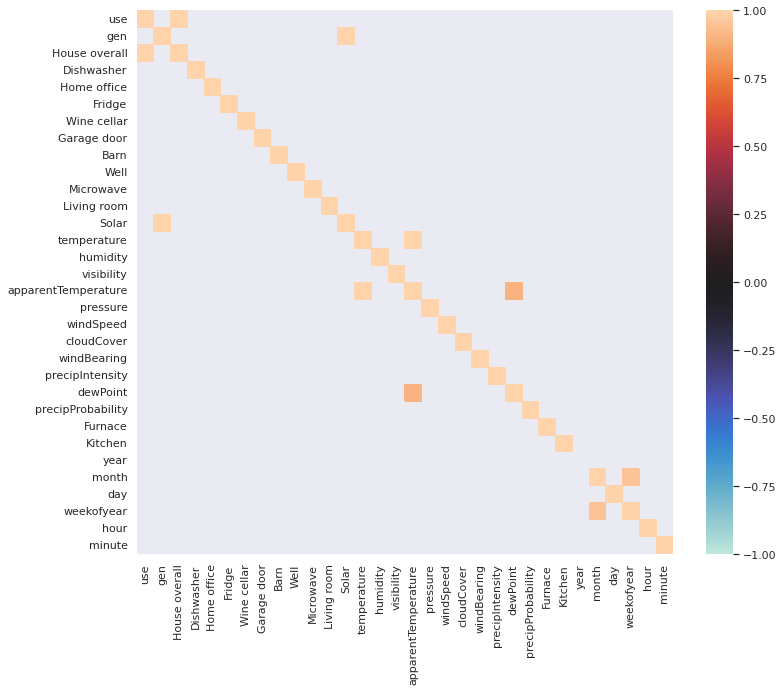

In [ ]:
fig = plt.subplots(figsize=(12, 10)) 
corr = df.corr()
sns.heatmap(corr[corr>0.9], vmax=1, vmin=-1, center=0)
plt.show()

`'use'` - `'House overall'` and `'gen'` and `'Solar'` columns' correlation coefficient is almost over 0.95, so we need to put these columns together as a new columns.

In [ ]:
df['use_HO'] = df['use']
df['gen_Sol'] = df['gen']
df.drop(['use','House overall','gen','Solar'], axis=1, inplace=True)
clear_output()
df

,time,Dishwasher,Home office,Fridge,Wine cellar,Garage door,Barn,Well,Microwave,Living room,...,year,month,day,weekday,weekofyear,hour,minute,timing,use_HO,gen_Sol
0,2016-01-01 05:00:00,0.000033,0.442633,0.124150,0.006983,0.013083,0.031350,0.001017,0.004067,0.001517,...,2016,1,1,Friday,53,5,0,Morning,0.932833,0.003483
1,2016-01-01 05:01:00,0.000000,0.444067,0.124000,0.006983,0.013117,0.031500,0.001017,0.004067,0.001650,...,2016,1,1,Friday,53,5,1,Morning,0.934333,0.003467
2,2016-01-01 05:02:00,0.000017,0.446067,0.123533,0.006983,0.013083,0.031517,0.001000,0.004067,0.001650,...,2016,1,1,Friday,53,5,2,Morning,0.931817,0.003467
3,2016-01-01 05:03:00,0.000017,0.446583,0.123133,0.006983,0.013000,0.031500,0.001017,0.004067,0.001617,...,2016,1,1,Friday,53,5,3,Morning,1.022050,0.003483
4,2016-01-01 05:04:00,0.000133,0.446533,0.122850,0.006850,0.012783,0.031500,0.001017,0.004067,0.001583,...,2016,1,1,Friday,53,5,4,Morning,1.139400,0.003467
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
503905,2016-12-16 03:25:00,0.000050,0.041783,0.005267,0.008667,0.013483,0.032283,0.000983,0.003800,0.000967,...,2016,12,16,Friday,50,3,25,Night,1.601233,0.003183
503906,2016-12-16 03:26:00,0.000050,0.041750,0.005233,0.008433,0.013433,0.032200,0.000950,0.003800,0.000933,...,2016,12,16,Friday,50,3,26,Night,1.599333,0.003233
503907,2016-12-16 03:27:00,0.000033,0.042033,0.004983,0.008467,0.012933,0.032283,0.001000,0.003750,0.001000,...,2016,12,16,Friday,50,3,27,Night,1.924267,0.003217
503908,2016-12-16 03:28:00,0.000050,0.042100,0.005333,0.008233,0.012817,0.032183,0.000950,0.003767,0.000950,...,2016,12,16,Friday,50,3,28,Night,1.978200,0.003217


In [ ]:
df = df.set_index(df['time'])
df

,time,Dishwasher,Home office,Fridge,Wine cellar,Garage door,Barn,Well,Microwave,Living room,...,year,month,day,weekday,weekofyear,hour,minute,timing,use_HO,gen_Sol
time,,,,,,,,,,,,,,,,,,,,,
2016-01-01 05:00:00,2016-01-01 05:00:00,0.000033,0.442633,0.124150,0.006983,0.013083,0.031350,0.001017,0.004067,0.001517,...,2016,1,1,Friday,53,5,0,Morning,0.932833,0.003483
2016-01-01 05:01:00,2016-01-01 05:01:00,0.000000,0.444067,0.124000,0.006983,0.013117,0.031500,0.001017,0.004067,0.001650,...,2016,1,1,Friday,53,5,1,Morning,0.934333,0.003467
2016-01-01 05:02:00,2016-01-01 05:02:00,0.000017,0.446067,0.123533,0.006983,0.013083,0.031517,0.001000,0.004067,0.001650,...,2016,1,1,Friday,53,5,2,Morning,0.931817,0.003467
2016-01-01 05:03:00,2016-01-01 05:03:00,0.000017,0.446583,0.123133,0.006983,0.013000,0.031500,0.001017,0.004067,0.001617,...,2016,1,1,Friday,53,5,3,Morning,1.022050,0.003483
2016-01-01 05:04:00,2016-01-01 05:04:00,0.000133,0.446533,0.122850,0.006850,0.012783,0.031500,0.001017,0.004067,0.001583,...,2016,1,1,Friday,53,5,4,Morning,1.139400,0.003467
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016-12-16 03:25:00,2016-12-16 03:25:00,0.000050,0.041783,0.005267,0.008667,0.013483,0.032283,0.000983,0.003800,0.000967,...,2016,12,16,Friday,50,3,25,Night,1.601233,0.003183
2016-12-16 03:26:00,2016-12-16 03:26:00,0.000050,0.041750,0.005233,0.008433,0.013433,0.032200,0.000950,0.003800,0.000933,...,2016,12,16,Friday,50,3,26,Night,1.599333,0.003233
2016-12-16 03:27:00,2016-12-16 03:27:00,0.000033,0.042033,0.004983,0.008467,0.012933,0.032283,0.001000,0.003750,0.001000,...,2016,12,16,Friday,50,3,27,Night,1.924267,0.003217


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 503910 entries, 2016-01-01 05:00:00 to 2016-12-16 03:29:00
Data columns (total 35 columns):
 #   Column               Non-Null Count   Dtype         
---  ------               --------------   -----         
 0   time                 503910 non-null  datetime64[ns]
 1   Dishwasher           503910 non-null  float64       
 2   Home office          503910 non-null  float64       
 3   Fridge               503910 non-null  float64       
 4   Wine cellar          503910 non-null  float64       
 5   Garage door          503910 non-null  float64       
 6   Barn                 503910 non-null  float64       
 7   Well                 503910 non-null  float64       
 8   Microwave            503910 non-null  float64       
 9   Living room          503910 non-null  float64       
 10  temperature          503910 non-null  float64       
 11  icon                 503910 non-null  object        
 12  humidity             503910 non-null  

In [ ]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Dishwasher,503910.0,0.031368,0.190951,0.000000,0.000000,0.000017,0.000233,1.401767
Home office,503910.0,0.081287,0.104466,0.000083,0.040383,0.042217,0.068283,0.971750
Fridge,503910.0,0.063556,0.076199,0.000067,0.005083,0.005433,0.125417,0.851267
Wine cellar,503910.0,0.042137,0.057967,0.000017,0.007133,0.008083,0.053192,1.273933
Garage door,503910.0,0.014139,0.014292,0.000017,0.012733,0.012933,0.013100,1.088983
Barn,503910.0,0.058530,0.202706,0.000000,0.029833,0.031317,0.032883,7.027900
Well,503910.0,0.015642,0.137841,0.000000,0.000983,0.001000,0.001017,1.633017
Microwave,503910.0,0.010983,0.098859,0.000000,0.003617,0.004000,0.004067,1.929800
Living room,503910.0,0.035313,0.096056,0.000000,0.001483,0.001617,0.001750,0.465217
temperature,503910.0,50.741935,19.113807,-12.640000,35.770000,50.320000,66.260000,93.720000


## **Time-series Model**

In [ ]:
df_new = df[:int(len(df)*0.8)]
df_new

,time,Dishwasher,Home office,Fridge,Wine cellar,Garage door,Barn,Well,Microwave,Living room,...,year,month,day,weekday,weekofyear,hour,minute,timing,use_HO,gen_Sol
time,,,,,,,,,,,,,,,,,,,,,
2016-01-01 05:00:00,2016-01-01 05:00:00,0.000033,0.442633,0.124150,0.006983,0.013083,0.031350,0.001017,0.004067,0.001517,...,2016,1,1,Friday,53,5,0,Morning,0.932833,0.003483
2016-01-01 05:01:00,2016-01-01 05:01:00,0.000000,0.444067,0.124000,0.006983,0.013117,0.031500,0.001017,0.004067,0.001650,...,2016,1,1,Friday,53,5,1,Morning,0.934333,0.003467
2016-01-01 05:02:00,2016-01-01 05:02:00,0.000017,0.446067,0.123533,0.006983,0.013083,0.031517,0.001000,0.004067,0.001650,...,2016,1,1,Friday,53,5,2,Morning,0.931817,0.003467
2016-01-01 05:03:00,2016-01-01 05:03:00,0.000017,0.446583,0.123133,0.006983,0.013000,0.031500,0.001017,0.004067,0.001617,...,2016,1,1,Friday,53,5,3,Morning,1.022050,0.003483
2016-01-01 05:04:00,2016-01-01 05:04:00,0.000133,0.446533,0.122850,0.006850,0.012783,0.031500,0.001017,0.004067,0.001583,...,2016,1,1,Friday,53,5,4,Morning,1.139400,0.003467
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016-10-07 03:43:00,2016-10-07 03:43:00,1.352700,0.063933,0.004183,0.127267,0.011450,0.032400,0.001050,0.002833,0.001950,...,2016,10,7,Friday,40,3,43,Night,2.265800,0.004900
2016-10-07 03:44:00,2016-10-07 03:44:00,1.343200,0.063500,0.004200,0.127217,0.011367,0.032283,0.001100,0.002883,0.001800,...,2016,10,7,Friday,40,3,44,Night,2.218167,0.004817
2016-10-07 03:45:00,2016-10-07 03:45:00,1.350350,0.066983,0.004250,0.082433,0.011450,0.032300,0.001083,0.002883,0.001800,...,2016,10,7,Friday,40,3,45,Night,2.195900,0.004867


In [ ]:
def plot_predictions1(model, X, y, title):
  predictions = model.predict(X).flatten()
  df = pd.DataFrame(data={'Predictions':predictions, 'Actuals':y})
  # plt.plot(df['Predictions'], label='Predictions')
  # plt.plot(df['Actuals'], label='Actuals')
  # plt.legend()

  fig = px.line(x=np.arange(len(df)), 
                y=[df['Actuals'], df['Predictions']],
                labels={'x':'time', 'value':'value'})
  # Set title and font
  fig.update_layout(title_text=f"<b>{title}</b>",
                    title_font_size=24,
                    title_font_family="serif",
                    title_font_color="black",
                    font_family="serif",
                    legend_title_text='<b>Labels</b>',
                    legend_borderwidth=1,
                    legend_orientation='h',
                    legend_xanchor='right',
                    legend_x=1,
                    legend_yanchor='bottom',
                    legend_y=1.02)
  # Set x label
  fig.update_xaxes(title_text = 'Day',
                  title_font_family="serif",
                  title_font_size=18)
  # Set y label
  fig.update_yaxes(title_text = 'Energy Consumption (kw)',
                  title_font_family="serif",
                  title_font_size=18)
  # Rename legend
  newnames = {'wide_variable_0':'Actual values', 
              'wide_variable_1':'Prediction values'}
  fig.for_each_trace(lambda t: t.update(name = newnames[t.name],
                                        legendgroup = newnames[t.name],
                                        hovertemplate = t.hovertemplate.replace(t.name, newnames[t.name])))
  fig.show()

  return df, mean_squared_error(y, predictions, squared=False)

In [ ]:
def plot_prediction(y, y_hat, title):
  df = pd.DataFrame(data={'Predictions':y_hat, 'Actuals':y})

  fig = px.line(x=np.arange(len(df)), 
                y=[df['Actuals'], df['Predictions']],
                labels={'x':'time', 'value':'value'})
  # Set title and font
  fig.update_layout(title_text=f"<b>{title}</b>",
                    title_font_size=24,
                    title_font_family="serif",
                    title_font_color="black",
                    font_family="serif",
                    legend_title_text='<b>Labels</b>',
                    legend_borderwidth=1,
                    legend_orientation='h',
                    legend_xanchor='right',
                    legend_x=1,
                    legend_yanchor='bottom',
                    legend_y=1.02)
  # Set x label
  fig.update_xaxes(title_text = 'Time',
                  title_font_family="serif",
                  title_font_size=18)
  # Set y label
  fig.update_yaxes(title_text = f'Energy Consumption (kw)',
                  title_font_family="serif",
                  title_font_size=18)
  # Rename legend
  newnames = {'wide_variable_0':'Actual values', 
              'wide_variable_1':'Prediction values'}
  fig.for_each_trace(lambda t: t.update(name = newnames[t.name],
                                        legendgroup = newnames[t.name],
                                        hovertemplate = t.hovertemplate.replace(t.name, newnames[t.name])))
  fig.show()

  return df, mean_squared_error(y, y_hat, squared=False)

### **Univariate Time Series Forecasting**

In [ ]:
# X = [[[1], [2], [3], [4], [5]]] y = [6]
# X = [[[2], [3], [4], [5], [6]]] y = [7]
# X = [[[3], [4], [5], [6], [7]]] y = [8]

def df_to_X_y(df, window_size=5):
  df_as_np = df.to_numpy()
  X = []
  y = []
  for i in range(len(df_as_np)-window_size):
    row = [[a] for a in df_as_np[i:i+window_size]]
    X.append(row)
    label = df_as_np[i+window_size]
    y.append(label)
  return np.array(X), np.array(y)

In [ ]:
WINDOW_SIZE1 = 60
size = len(df_new)
series = df_new['use_HO']
X1, y1 = df_to_X_y(series, WINDOW_SIZE1)
X1.shape, y1.shape

((403068, 60, 1), (403068,))

In [ ]:
X_train1, y_train1 = X1[:int(size*0.7)], y1[:int(size*0.7)]
X_val1, y_val1 = X1[int(size*0.7):int(size*0.8)], y1[int(size*0.7):int(size*0.8)]
X_test1, y_test1 = X1[int(size*0.8):], y1[int(size*0.8):]
X_train1.shape, y_train1.shape, X_val1.shape, y_val1.shape, X_test1.shape, y_test1.shape

((282189, 60, 1),
 (282189,),
 (40313, 60, 1),
 (40313,),
 (80566, 60, 1),
 (80566,))

#### **GRU Model**

In [ ]:
model_gru = Sequential()
model_gru.add(InputLayer((WINDOW_SIZE1, 1)))
model_gru.add(GRU(64))
model_gru.add(Dense(8, 'relu'))
model_gru.add(Dense(1, 'linear'))
model_gru.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru (GRU)                   (None, 64)                12864     
                                                                 
 dense (Dense)               (None, 8)                 520       
                                                                 
 dense_1 (Dense)             (None, 1)                 9         
                                                                 
Total params: 13,393
Trainable params: 13,393
Non-trainable params: 0
_________________________________________________________________


In [ ]:
cp2 = ModelCheckpoint(PATH+'model_gru/', save_best_only=True)
model_gru.compile(loss=MeanSquaredError(), optimizer=Adam(learning_rate=1e-4), metrics=[RootMeanSquaredError()])

In [ ]:
%%time
history_gru = model_gru.fit(X_train1, y_train1, 
                            validation_data=(X_val1, y_val1), 
                            callbacks=[cp2],
                            epochs=10)

Epoch 1/10
8819/8819 [==============================] - ETA: 0s - loss: 0.1065 - root_mean_squared_error: 0.3264

8819/8819 [==============================] - 444s 50ms/step - loss: 0.1065 - root_mean_squared_error: 0.3264 - val_loss: 0.6421 - val_root_mean_squared_error: 0.8013
Epoch 2/10
8818/8819 [============================>.] - ETA: 0s - loss: 0.0929 - root_mean_squared_error: 0.3049

8819/8819 [==============================] - 447s 51ms/step - loss: 0.0929 - root_mean_squared_error: 0.3049 - val_loss: 0.5968 - val_root_mean_squared_error: 0.7725
Epoch 3/10
8819/8819 [==============================] - ETA: 0s - loss: 0.0900 - root_mean_squared_error: 0.2999

8819/8819 [==============================] - 440s 50ms/step - loss: 0.0900 - root_mean_squared_error: 0.2999 - val_loss: 0.5830 - val_root_mean_squared_error: 0.7635
Epoch 4/10
8819/8819 [==============================] - ETA: 0s - loss: 0.0879 - root_mean_squared_error: 0.2966

8819/8819 [==============================] - 432s 49ms/step - loss: 0.0879 - root_mean_squared_error: 0.2966 - val_loss: 0.5006 - val_root_mean_squared_error: 0.7075
Epoch 5/10
8818/8819 [============================>.] - ETA: 0s - loss: 0.0862 - root_mean_squared_error: 0.2936

8819/8819 [==============================] - 445s 50ms/step - loss: 0.0862 - root_mean_squared_error: 0.2936 - val_loss: 0.4841 - val_root_mean_squared_error: 0.6958
Epoch 6/10
8819/8819 [==============================] - ETA: 0s - loss: 0.0847 - root_mean_squared_error: 0.2910

8819/8819 [==============================] - 449s 51ms/step - loss: 0.0847 - root_mean_squared_error: 0.2910 - val_loss: 0.4821 - val_root_mean_squared_error: 0.6944
Epoch 7/10
8819/8819 [==============================] - 442s 50ms/step - loss: 0.0838 - root_mean_squared_error: 0.2895 - val_loss: 0.4889 - val_root_mean_squared_error: 0.6992
Epoch 8/10
8819/8819 [==============================] - ETA: 0s - loss: 0.0831 - root_mean_squared_error: 0.2883

8819/8819 [==============================] - 441s 50ms/step - loss: 0.0831 - root_mean_squared_error: 0.2883 - val_loss: 0.4644 - val_root_mean_squared_error: 0.6815
Epoch 9/10
8819/8819 [==============================] - ETA: 0s - loss: 0.0825 - root_mean_squared_error: 0.2872

8819/8819 [==============================] - 434s 49ms/step - loss: 0.0825 - root_mean_squared_error: 0.2872 - val_loss: 0.4575 - val_root_mean_squared_error: 0.6764
Epoch 10/10
8819/8819 [==============================] - ETA: 0s - loss: 0.0819 - root_mean_squared_error: 0.2862

8819/8819 [==============================] - 471s 53ms/step - loss: 0.0819 - root_mean_squared_error: 0.2862 - val_loss: 0.4569 - val_root_mean_squared_error: 0.6760
CPU times: user 1h 31min 14s, sys: 2min 23s, total: 1h 33min 37s
Wall time: 1h 14min 27s


In [ ]:
model_gru = load_model(PATH+'model_gru/')

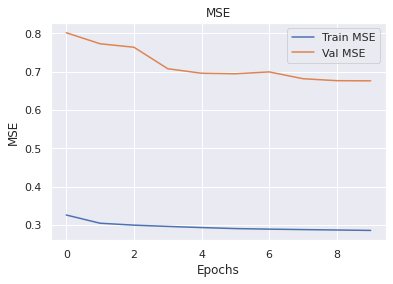

In [ ]:
plt.figure(0)
plt.plot(history_gru.history['root_mean_squared_error'], label = 'Train MSE')
plt.plot(history_gru.history['val_root_mean_squared_error'], label = 'Val MSE')
plt.title('MSE')
plt.xlabel('Epochs')
plt.ylabel('MSE')
plt.legend()
plt.show()

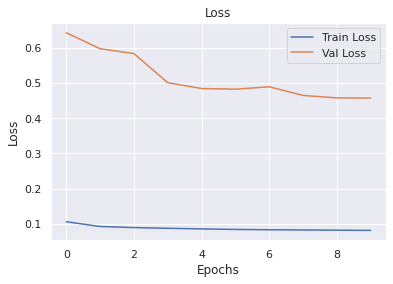

In [ ]:
plt.figure(0)
plt.plot(history_gru.history['loss'], label = 'Train Loss')
plt.plot(history_gru.history['val_loss'], label = 'Val Loss')
plt.title('Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [ ]:
plot_predictions1(model_gru, X_train1, y_train1, 'Result on Train Set of GRU Model')

In [ ]:
plot_predictions1(model_gru, X_val1, y_val1, 'Result on Val Set of GRU Model')

1260/1260 [==============================] - 20s 16ms/step


(       Predictions   Actuals
 0         2.019437  1.949067
 1         2.015801  1.952483
 2         2.017107  1.914750
 3         1.944657  0.921317
 4         0.646242  0.485383
 ...            ...       ...
 40308     0.613036  0.494167
 40309     0.605748  0.492817
 40310     0.586054  0.491850
 40311     0.654620  0.492633
 40312     0.684599  0.496533
 
 [40313 rows x 2 columns], 0.6759724259865489)

In [ ]:
plot_predictions1(model_gru, X_test1, y_test1, 'Result on Test Set of GRU Model')

2518/2518 [==============================] - 32s 13ms/step


(       Predictions   Actuals
 0         0.697921  0.492467
 1         0.694888  0.492217
 2         0.703590  0.492117
 3         0.712245  0.491933
 4         0.713545  0.499200
 ...            ...       ...
 80561     1.610405  2.265800
 80562     2.081940  2.218167
 80563     1.998158  2.195900
 80564     2.004021  2.139550
 80565     1.996748  2.131583
 
 [80566 rows x 2 columns], 0.49952638693913354)

In [ ]:
result = plot_predictions1(model_gru, X_test1, y_test1, 'Result on Test Set of GRU Model')[0]

2518/2518 [==============================] - 30s 12ms/step


In [ ]:
df_result = pd.DataFrame()
df_result['Actuals'] = result[['Actuals']][1:]
df_result['Predictions_UniGRU'] = result[['Predictions']][1:]
df_result

,Actuals,Predictions_UniGRU
1,0.492217,0.694888
2,0.492117,0.703590
3,0.491933,0.712245
4,0.499200,0.713545
5,0.500300,0.726727
...,...,...
80561,2.265800,1.610405
80562,2.218167,2.081940
80563,2.195900,1.998158
80564,2.139550,2.004021


### **Multivariate Time Series Forecasting using [temperature]**

In [ ]:
%%time
tsdata_train, tsdata_valid, tsdata_test = TSDataset.from_pandas(df_new, dt_col="time", target_col="use_HO",
                                                                extra_feature_col=['temperature'],
                                                                with_split=True, val_ratio=0.1, test_ratio=0.2)

lookback, horizon = 60, 1

scaler = StandardScaler()
for tsdata in [tsdata_train, tsdata_valid, tsdata_test]:
    tsdata.deduplicate()\
          .impute()\
          .gen_dt_feature()\
          .scale(scaler, fit=(tsdata is tsdata_train))\
          .roll(lookback=lookback, horizon=horizon)

CPU times: user 17.2 s, sys: 9.39 s, total: 26.6 s
Wall time: 37.4 s


#### **Seq2SeqForecaster**

In [ ]:
x, y = tsdata_train.to_numpy()
x_val, y_val = tsdata_valid.to_numpy()
# x.shape = (num of sample, lookback, num of input feature)
# y.shape = (num of sample, horizon, num of output feature)

Seq2Seqforecaster_T = Seq2SeqForecaster(past_seq_len=lookback,  # number of steps to look back
                           future_seq_len=horizon,  # number of steps to predict
                           input_feature_num=x.shape[-1],  # number of feature to use
                           output_feature_num=y.shape[-1],  # number of feature to predict
                           seed=1)

INFO:pytorch_lightning.utilities.seed:Global seed set to 1
INFO:pytorch_lightning.utilities.seed:Global seed set to 1


In [ ]:
%%time
res = Seq2Seqforecaster_T.fit((x, y), epochs=3, validation_data=(x_val, y_val))

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type             | Params
-------------------------------------------
0 | model | NormalizeTSModel | 104 K 
1 | loss  | MSELoss          | 0     
-------------------------------------------
104 K     Trainable params
0         Non-trainable params
104 K     Total params
0.416     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

CPU times: user 44min 27s, sys: 20.7 s, total: 44min 48s
Wall time: 48min 13s


In [ ]:
x_train, y_train = tsdata_train.to_numpy()
pred = Seq2Seqforecaster_T.predict(x_train)
pred_unscale, groundtruth_unscale = tsdata_train.unscale_numpy(pred), tsdata_train.unscale_numpy(y_train)

rmse = mean_squared_error(groundtruth_unscale[:,:,0], pred_unscale[:,:,0], squared=False)
print(f'RMSE = {rmse}')

RMSE = 0.2808013322336589


In [ ]:
x_val, y_val = tsdata_valid.to_numpy()
pred = Seq2Seqforecaster_T.predict(x_val)
pred_unscale, groundtruth_unscale = tsdata_valid.unscale_numpy(pred), tsdata_valid.unscale_numpy(y_val)

rmse = mean_squared_error(groundtruth_unscale[:,:,0], pred_unscale[:,:,0], squared=False)
print(f'RMSE = {rmse}')

RMSE = 0.6820710844285375


In [ ]:
x_test, y_test = tsdata_test.to_numpy()
pred = Seq2Seqforecaster_T.predict(x_test)
pred_unscale, groundtruth_unscale = tsdata_test.unscale_numpy(pred), tsdata_test.unscale_numpy(y_test)

rmse = mean_squared_error(groundtruth_unscale[:,:,0], pred_unscale[:,:,0], squared=False)
print(f'RMSE = {rmse}')

RMSE = 0.5035747293788396


In [ ]:
Predictions = []
Actuals = []
for i in range(len(pred_unscale[:,:,0])):
  Actuals.append(groundtruth_unscale[:,:,0].item(i))
  Predictions.append(pred_unscale[:,:,0].item(i))

plot_prediction(Actuals, Predictions, 'Result on Test Set of Chronos Forecaster')

(       Predictions   Actuals
 0         0.678670  0.492217
 1         0.662378  0.492117
 2         0.643771  0.491933
 3         0.620246  0.499200
 4         0.617840  0.500300
 ...            ...       ...
 80560     1.606537  2.265800
 80561     2.006832  2.218167
 80562     1.926577  2.195900
 80563     1.958438  2.139550
 80564     1.905940  2.131583
 
 [80565 rows x 2 columns], 0.5035747293788396)

In [ ]:
df_result['Predictions_Seq2SeqForecasterMulti [T]'] = Predictions
df_result

,Actuals,Predictions_UniGRU,Predictions_Seq2SeqForecasterMulti [T]
1,0.492217,0.694888,0.678670
2,0.492117,0.703590,0.662378
3,0.491933,0.712245,0.643771
4,0.499200,0.713545,0.620246
5,0.500300,0.726727,0.617840
...,...,...,...
80561,2.265800,1.610405,1.606537
80562,2.218167,2.081940,2.006832
80563,2.195900,1.998158,1.926577
80564,2.139550,2.004021,1.958438


In [ ]:
Seq2Seqforecaster_T.save(PATH+"Seq2SeqForecaster_m1.fxt")

In [ ]:
Seq2Seqforecaster_T.load(PATH+"Seq2SeqForecaster_m1.fxt")

INFO:pytorch_lightning.utilities.seed:Global seed set to 1
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


### **Multivariate Time Series Forecasting using [temperature, humidity]**

In [ ]:
%%time
tsdata_train, tsdata_valid, tsdata_test = TSDataset.from_pandas(df_new, dt_col="time", target_col="use_HO",
                                                                extra_feature_col=['temperature', 'humidity'],
                                                                with_split=True, val_ratio=0.1, test_ratio=0.2)

lookback, horizon = 60, 1

scaler = StandardScaler()
for tsdata in [tsdata_train, tsdata_valid, tsdata_test]:
    tsdata.deduplicate()\
          .impute()\
          .gen_dt_feature()\
          .scale(scaler, fit=(tsdata is tsdata_train))\
          .roll(lookback=lookback, horizon=horizon)

CPU times: user 18.5 s, sys: 7.4 s, total: 25.9 s
Wall time: 26.3 s


#### **LSTMForecaster**

In [ ]:
x, y = tsdata_train.to_numpy()
x_val, y_val = tsdata_valid.to_numpy()
# x.shape = (num of sample, lookback, num of input feature)
# y.shape = (num of sample, horizon, num of output feature)

LSTMforecaster_TH = LSTMForecaster(past_seq_len=lookback,  # number of steps to look back
                          #  future_seq_len=horizon,  # number of steps to predict
                           input_feature_num=x.shape[-1],  # number of feature to use
                           output_feature_num=y.shape[-1],  # number of feature to predict
                           seed=1)

INFO:pytorch_lightning.utilities.seed:Global seed set to 1
INFO:pytorch_lightning.utilities.seed:Global seed set to 1


In [ ]:
%%time
res = LSTMforecaster_TH.fit((x, y), epochs=3, validation_data=(x_val, y_val))

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type             | Params
-------------------------------------------
0 | model | NormalizeTSModel | 6.2 K 
1 | loss  | MSELoss          | 0     
-------------------------------------------
6.2 K     Trainable params
0         Non-trainable params
6.2 K     Total params
0.025     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

CPU times: user 20min 26s, sys: 16.4 s, total: 20min 43s
Wall time: 22min 42s


In [ ]:
x_train, y_train = tsdata_train.to_numpy()
pred = LSTMforecaster_TH.predict(x_train)
pred_unscale, groundtruth_unscale = tsdata_train.unscale_numpy(pred), tsdata_train.unscale_numpy(y_train)

rmse = mean_squared_error(groundtruth_unscale[:,:,0], pred_unscale[:,:,0], squared=False)
print(f'RMSE = {rmse}')

RMSE = 0.28098029980887057


In [ ]:
x_val, y_val = tsdata_valid.to_numpy()
pred = LSTMforecaster_TH.predict(x_val)
pred_unscale, groundtruth_unscale = tsdata_valid.unscale_numpy(pred), tsdata_valid.unscale_numpy(y_val)

rmse = mean_squared_error(groundtruth_unscale[:,:,0], pred_unscale[:,:,0], squared=False)
print(f'RMSE = {rmse}')

RMSE = 0.6628559824522555


In [ ]:
x_test, y_test = tsdata_test.to_numpy()
pred = LSTMforecaster_TH.predict(x_test)
pred_unscale, groundtruth_unscale = tsdata_test.unscale_numpy(pred), tsdata_test.unscale_numpy(y_test)

rmse = mean_squared_error(groundtruth_unscale[:,:,0], pred_unscale[:,:,0], squared=False)
print(f'RMSE = {rmse}')

RMSE = 0.48904282901276247


In [ ]:
Predictions = []
Actuals = []
for i in range(len(pred_unscale[:,:,0])):
  Actuals.append(groundtruth_unscale[:,:,0].item(i))
  Predictions.append(pred_unscale[:,:,0].item(i))

plot_prediction(Actuals, Predictions, 'Result on Test Set of Chronos Forecaster')

(       Predictions   Actuals
 0         0.644107  0.492217
 1         0.625998  0.492117
 2         0.607484  0.491933
 3         0.590791  0.499200
 4         0.586832  0.500300
 ...            ...       ...
 80560     1.880262  2.265800
 80561     2.130310  2.218167
 80562     2.040170  2.195900
 80563     2.034976  2.139550
 80564     1.947794  2.131583
 
 [80565 rows x 2 columns], 0.48904282901276247)

In [ ]:
df_result['Predictions_LSTMForecasterMulti [T, H]'] = Predictions
df_result

,Actuals,Predictions_UniGRU,Predictions_Seq2SeqForecasterMulti [T],"Predictions_LSTMForecasterMulti [T, H]"
1,0.492217,0.694888,0.678670,0.644107
2,0.492117,0.703590,0.662378,0.625998
3,0.491933,0.712245,0.643771,0.607484
4,0.499200,0.713545,0.620246,0.590791
5,0.500300,0.726727,0.617840,0.586832
...,...,...,...,...
80561,2.265800,1.610405,1.606537,1.880262
80562,2.218167,2.081940,2.006832,2.130310
80563,2.195900,1.998158,1.926577,2.040170
80564,2.139550,2.004021,1.958438,2.034976


In [ ]:
LSTMforecaster_TH.save(PATH+"LSTMForecaster_m2.fxt")

In [ ]:
LSTMforecaster_TH.load(PATH+"LSTMForecaster_m2.fxt")

INFO:pytorch_lightning.utilities.seed:Global seed set to 1
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


### **Multivariate Time Series Forecasting using [temperature, humidity, windSpeed]**

In [ ]:
%%time
tsdata_train, tsdata_valid, tsdata_test = TSDataset.from_pandas(df_new, dt_col="time", target_col="use_HO",
                                                                extra_feature_col=['temperature', 'humidity', 'windSpeed'],
                                                                with_split=True, val_ratio=0.1, test_ratio=0.2)

lookback, horizon = 60, 1

scaler = StandardScaler()
for tsdata in [tsdata_train, tsdata_valid, tsdata_test]:
    tsdata.deduplicate()\
          .impute()\
          .gen_dt_feature()\
          .scale(scaler, fit=(tsdata is tsdata_train))\
          .roll(lookback=lookback, horizon=horizon)

CPU times: user 18.4 s, sys: 7.48 s, total: 25.8 s
Wall time: 26.6 s


#### **LSTMForecaster**

In [ ]:
x, y = tsdata_train.to_numpy()
x_val, y_val = tsdata_valid.to_numpy()
# x.shape = (num of sample, lookback, num of input feature)
# y.shape = (num of sample, horizon, num of output feature)

LSTMforecaster_THW = LSTMForecaster(past_seq_len=lookback,  # number of steps to look back
                          #  future_seq_len=horizon,  # number of steps to predict
                           input_feature_num=x.shape[-1],  # number of feature to use
                           output_feature_num=y.shape[-1],  # number of feature to predict
                           seed=1)

INFO:pytorch_lightning.utilities.seed:Global seed set to 1
INFO:pytorch_lightning.utilities.seed:Global seed set to 1


In [ ]:
%%time
res = LSTMforecaster_THW.fit((x, y), epochs=3, validation_data=(x_val, y_val))

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type             | Params
-------------------------------------------
0 | model | NormalizeTSModel | 6.3 K 
1 | loss  | MSELoss          | 0     
-------------------------------------------
6.3 K     Trainable params
0         Non-trainable params
6.3 K     Total params
0.025     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

CPU times: user 20min 26s, sys: 16.3 s, total: 20min 43s
Wall time: 22min 51s


In [ ]:
x_train, y_train = tsdata_train.to_numpy()
pred = LSTMforecaster_THW.predict(x_train)
pred_unscale, groundtruth_unscale = tsdata_train.unscale_numpy(pred), tsdata_train.unscale_numpy(y_train)

rmse = mean_squared_error(groundtruth_unscale[:,:,0], pred_unscale[:,:,0], squared=False)
print(f'RMSE = {rmse}')

RMSE = 0.2842270807310597


In [ ]:
x_val, y_val = tsdata_valid.to_numpy()
pred = LSTMforecaster_THW.predict(x_val)
pred_unscale, groundtruth_unscale = tsdata_valid.unscale_numpy(pred), tsdata_valid.unscale_numpy(y_val)

rmse = mean_squared_error(groundtruth_unscale[:,:,0], pred_unscale[:,:,0], squared=False)
print(f'RMSE = {rmse}')

RMSE = 0.6771442139304783


In [ ]:
x_test, y_test = tsdata_test.to_numpy()
pred = LSTMforecaster_THW.predict(x_test)
pred_unscale, groundtruth_unscale = tsdata_test.unscale_numpy(pred), tsdata_test.unscale_numpy(y_test)

rmse = mean_squared_error(groundtruth_unscale[:,:,0], pred_unscale[:,:,0], squared=False)
print(f'RMSE = {rmse}')

RMSE = 0.4989203851517404


In [ ]:
Predictions = []
Actuals = []
for i in range(len(pred_unscale[:,:,0])):
  Actuals.append(groundtruth_unscale[:,:,0].item(i))
  Predictions.append(pred_unscale[:,:,0].item(i))

plot_prediction(Actuals, Predictions, 'Result on Test Set of Chronos Forecaster')

(       Predictions   Actuals
 0         0.739204  0.492217
 1         0.725148  0.492117
 2         0.705323  0.491933
 3         0.683634  0.499200
 4         0.672985  0.500300
 ...            ...       ...
 80560     1.576032  2.265800
 80561     1.997504  2.218167
 80562     2.023026  2.195900
 80563     1.947184  2.139550
 80564     1.927925  2.131583
 
 [80565 rows x 2 columns], 0.4989203851517404)

In [ ]:
df_result['Predictions_LSTMForecasterMulti [T, H, W]'] = Predictions
df_result

,Actuals,Predictions_UniGRU,Predictions_Seq2SeqForecasterMulti [T],"Predictions_LSTMForecasterMulti [T, H]","Predictions_LSTMForecasterMulti [T, H, W]"
1,0.492217,0.694888,0.678670,0.644107,0.739204
2,0.492117,0.703590,0.662378,0.625998,0.725148
3,0.491933,0.712245,0.643771,0.607484,0.705323
4,0.499200,0.713545,0.620246,0.590791,0.683634
5,0.500300,0.726727,0.617840,0.586832,0.672985
...,...,...,...,...,...
80561,2.265800,1.610405,1.606537,1.880262,1.576032
80562,2.218167,2.081940,2.006832,2.130310,1.997504
80563,2.195900,1.998158,1.926577,2.040170,2.023026
80564,2.139550,2.004021,1.958438,2.034976,1.947184


In [ ]:
LSTMforecaster_THW.save(PATH+"LSTMForecaster_m3.fxt")

In [ ]:
LSTMforecaster_THW.load(PATH+"LSTMForecaster_m3.fxt")

INFO:pytorch_lightning.utilities.seed:Global seed set to 1
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


## **Result**

In [ ]:
df_result

,Actuals,Predictions_UniGRU,Predictions_Seq2SeqForecasterMulti [T],"Predictions_LSTMForecasterMulti [T, H]","Predictions_LSTMForecasterMulti [T, H, W]"
1,0.492217,0.694888,0.678670,0.644107,0.739204
2,0.492117,0.703590,0.662378,0.625998,0.725148
3,0.491933,0.712245,0.643771,0.607484,0.705323
4,0.499200,0.713545,0.620246,0.590791,0.683634
5,0.500300,0.726727,0.617840,0.586832,0.672985
...,...,...,...,...,...
80561,2.265800,1.610405,1.606537,1.880262,1.576032
80562,2.218167,2.081940,2.006832,2.130310,1.997504
80563,2.195900,1.998158,1.926577,2.040170,2.023026
80564,2.139550,2.004021,1.958438,2.034976,1.947184


In [ ]:
def plot_result(df, title, start=0, end=200):
  fig = px.line(x=np.arange(end-start), 
                y=[df['Actuals'][start:end], 
                   df['Predictions_UniGRU'][start:end],
                   df['Predictions_Seq2SeqForecasterMulti [T]'][start:end],
                   df['Predictions_LSTMForecasterMulti [T, H]'][start:end],
                   df['Predictions_LSTMForecasterMulti [T, H, W]'][start:end]],
                labels={'x':'time', 'value':'value'})
  # Set title and font
  fig.update_layout(title_text=f"<b>{title}</b>",
                    title_font_size=24,
                    title_font_family="serif",
                    title_font_color="black",
                    font_family="serif",
                    legend_title_text='<b>Labels</b>',
                    legend_borderwidth=1)
  # Set x label
  fig.update_xaxes(title_text = 'Time',
                  title_font_family="serif",
                  title_font_size=18)
  # Set y label
  fig.update_yaxes(title_text = f'Energy Consumption (kw)',
                  title_font_family="serif",
                  title_font_size=18)
  # Rename legend
  newnames = {'wide_variable_0':'Actual values', 
              'wide_variable_1':'Predictions_UniGRU values',
              'wide_variable_2':'Predictions_MultiSeq2SeqForecaster [T] values',
              'wide_variable_3':'Predictions_MultiLSTMForecaster [T, H] values',
              'wide_variable_4':'Predictions_MultiLSTMForecaster [T, H, W] values',}
  fig.for_each_trace(lambda t: t.update(name = newnames[t.name],
                                        legendgroup = newnames[t.name],
                                        hovertemplate = t.hovertemplate.replace(t.name, newnames[t.name])))
  fig.show()

  # return df, mean_squared_error(y, y_hat, squared=False)

In [ ]:
def plot_result1(df, title, start=0, end=200):
  plt.figure(figsize=(22, 8))

  sns.lineplot(np.arange(end-start), df['Actuals'][start:end], label='Actuals')
  sns.lineplot(np.arange(end-start), df['Predictions_UniGRU'][start:end], label='Predictions_UniGRU')
  sns.lineplot(np.arange(end-start), df['Predictions_Seq2SeqForecasterMulti [T]'][start:end], label='Predictions_MultiSeq2SeqForecaster [T]')
  sns.lineplot(np.arange(end-start), df['Predictions_LSTMForecasterMulti [T, H]'][start:end], label='Predictions_MultiLSTMForecaster [T, H]')
  sns.lineplot(np.arange(end-start), df['Predictions_LSTMForecasterMulti [T, H, W]'][start:end], label='Predictions_MultiLSTMForecaster [T, H, W]')

  plt.xlabel('Time', fontsize=14, fontfamily='serif')
  plt.ylabel('Energy Consumption (kw)', fontsize=14, fontfamily='serif')

  # plt.title(f'{title}')

  plt.legend()
  plt.show()


In [ ]:
plot_result(df_result, 'Result of Models on Test Set', 0, 100)

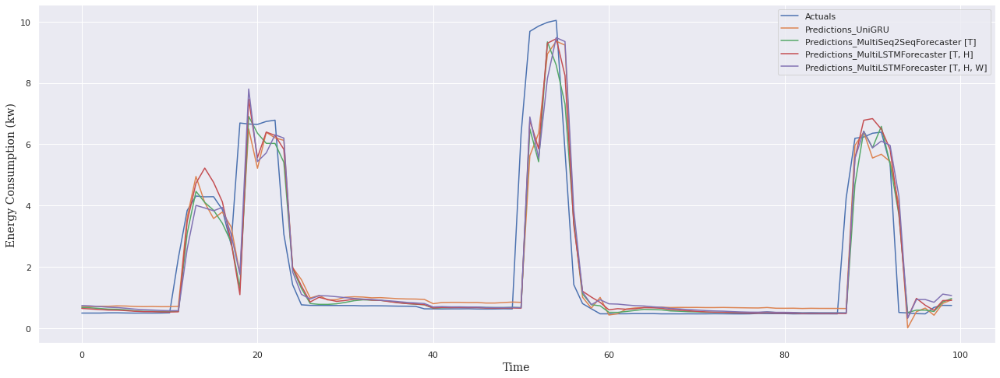

In [ ]:
plot_result1(df_result, 'Result of Models on Test Set', 0, 100)